<img src = "https://global-uploads.webflow.com/5f0d53c042a9ed6288de7f8d/5f6337ae2cfaa10946ceeb06_Hacktiv8%20logo%20horizontal%2001%20black-p-500.png" width = 400>
<h1 align=center><font size = 5>Hacktiv8 PTP Introduction to Data Science Final Project   </font></h1>

## Pengenalan

- Topik: **Clustering**
- Data : Credit Card Clustering
- Sumber data: https://www.kaggle.com/arjunbhasin2013/ccdata?select=CC+GENERAL.csv
- Tujuan: Melakukan Clustering untuk menentukan strategi marketing offering transaksi menjadi cicilan kartu kredit

This case requires to develop a customer segmentation to define marketing strategy. The
sample Dataset summarizes the usage behavior of about 9000 active credit card holders during the last 6 months. The file is at a customer level with 18 behavioral variables.

Following is the Data Dictionary for Credit Card dataset :-

- CUSTID : Identification of Credit Card holder (Categorical)
- BALANCE : Balance amount left in their account to make purchases (
- BALANCEFREQUENCY : How frequently the Balance is updated, score between 0 and 1 (1 = frequently updated, 0 = not frequently updated)
- PURCHASES : Amount of purchases made from account
- ONEOFFPURCHASES : Maximum purchase amount done in one-go
- INSTALLMENTSPURCHASES : Amount of purchase done in installment
- CASHADVANCE : Cash in advance given by the user
- PURCHASESFREQUENCY : How frequently the Purchases are being made, score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased)
- ONEOFFPURCHASESFREQUENCY : How frequently Purchases are happening in one-go (1 = frequently purchased, 0 = not frequently purchased)
- PURCHASESINSTALLMENTSFREQUENCY : How frequently purchases in installments are being done (1 = frequently done, 0 = not frequently done)
- CASHADVANCEFREQUENCY : How frequently the cash in advance being paid
- CASHADVANCETRX : Number of Transactions made with "Cash in Advanced"
- PURCHASESTRX : Numbe of purchase transactions made
- CREDITLIMIT : Limit of Credit Card for user
- PAYMENTS : Amount of Payment done by user
- MINIMUM_PAYMENTS : Minimum amount of payments made by user
- PRCFULLPAYMENT : Percent of full payment paid by user
- TENURE : Tenure of credit card service for user

## Pustaka

In [1]:
!pip install pandas_profiling
!pip install seaborn

# import pustaka yang dibutuhkan
import pandas as pd
import numpy as np
import pandas_profiling
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
import pickle #to save the model

%matplotlib inline 

from sklearn.model_selection import train_test_split

from matplotlib.ticker import MultipleLocator #scatter plot
from sklearn.preprocessing import StandardScaler #normalisasi data
from sklearn.cluster import KMeans # clustering menggunakan kmeans\
from sklearn.decomposition import PCA #decomposition x features menjadi sejumlah PCA


## Data Loading and Exploratory Data Analysis (EDA)

In [2]:
# Download data dari 

# Read the data dengan separator tertentu 
cc=pd.read_csv('data/CC GENERAL.csv',sep=',') 
print ('Data read into a pandas dataframe!')


Data read into a pandas dataframe!


In [3]:
cc.shape

(8950, 18)

In [4]:
cc.tail()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.50,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.00,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.25,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.25,6
8949,C19190,372.708075,0.666667,1093.25,1093.25,0.00,127.040008,0.666667,0.666667,0.000000,0.333333,2,23,1200.0,63.165404,88.288956,0.00,6


In [5]:
cc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [6]:
report=cc.profile_report(title='CC Behavior',
                          progress_bar=False)
report

- Terdapat missing values yang cukup banyak pada 'MINIMUM_PAYMENTS'.
- Untuk menyusun strategi penawaran installment purchasing, terlihat korelasi antara PURCHASES_INSTALLMENTS_FREQUENCY dengan  PURCHASES, CASH_ADVANCE_FREQUENCY, PURCHASES_TRX.

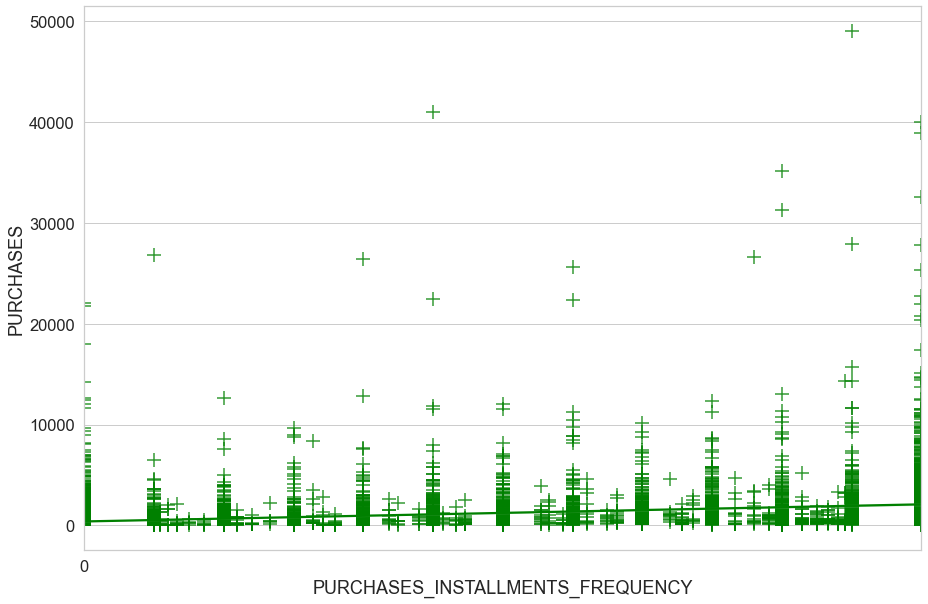

In [7]:
# Data Visualization using scatter plot to get the sense of data relationship

def myScatter(myX, myY,myData):

    plt.figure(figsize=(15,10))
    sns.set(font_scale=1.5)
    sns.set_style('whitegrid')
    ax=sns.regplot(
        x=myX,
        y=myY,
        color='green',
        marker='+',  #bentuk marker
        scatter_kws={'s':200}, #ukuran marker
        data=myData)
    ax.xaxis.set_major_locator(MultipleLocator(12))
    ax.set(xlabel=myX,ylabel=myY)
    #ax.set_title('Relationship between Purchase Installment Frequency and Cash Advance')
    
myScatter('PURCHASES_INSTALLMENTS_FREQUENCY','PURCHASES',cc)

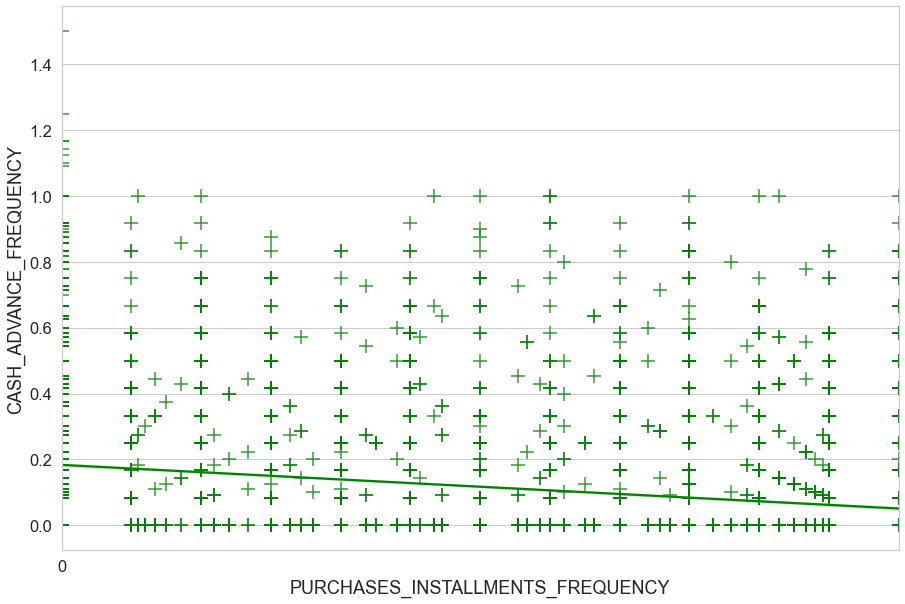

In [8]:
myScatter('PURCHASES_INSTALLMENTS_FREQUENCY','CASH_ADVANCE_FREQUENCY',cc)

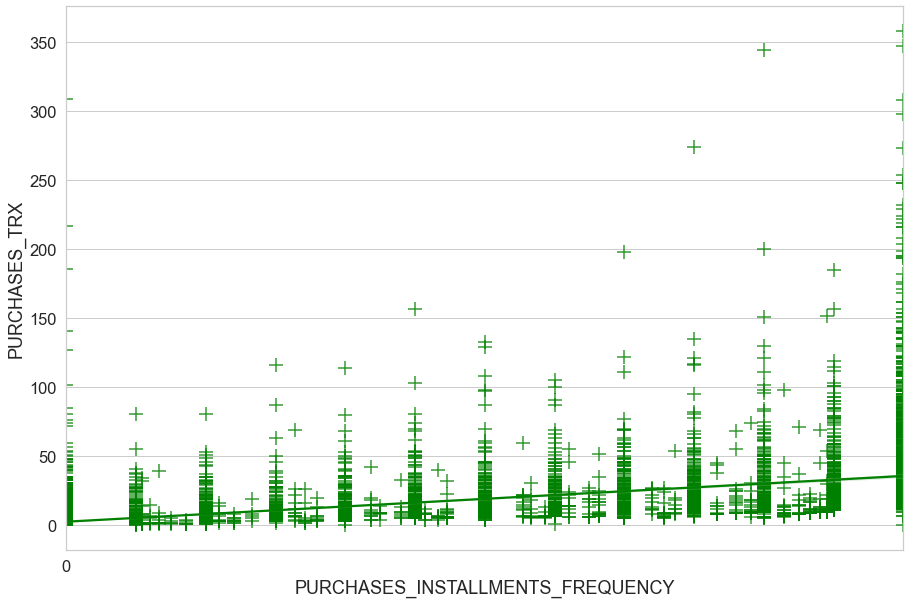

In [9]:
myScatter('PURCHASES_INSTALLMENTS_FREQUENCY','PURCHASES_TRX',cc)

Dari scatter plot yang kita buat, terlihat tren sbb:
- tren 'PURCHASES_INSTALLMENTS_FREQUENCY' lebih tinggi pada nilai 'PURCHASES' yang tinggi.
- tren 'PURCHASES_INSTALLMENTS_FREQUENCY' lebih tinggi pada nilai 'CASH_ADVANCE_FREQUENCY' yang rendah.
- tren 'PURCHASES_INSTALLMENTS_FREQUENCY' lebih tinggi pada nilai 'PURCHASES_TRX' yang tinggi.

## Data Preprocessing

In [10]:
cc[cc['MINIMUM_PAYMENTS'].isnull()]

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.0,12
45,C10047,2242.311686,1.000000,437.00,97.00,340.0,184.648692,0.333333,0.083333,0.333333,0.166667,2,5,2400.0,0.000000,NaN,0.0,12
47,C10049,3910.111237,1.000000,0.00,0.00,0.0,1980.873201,0.000000,0.000000,0.000000,0.500000,7,0,4200.0,0.000000,NaN,0.0,12
54,C10056,6.660517,0.636364,310.00,0.00,310.0,0.000000,0.666667,0.000000,0.666667,0.000000,0,8,1000.0,417.016763,NaN,0.0,12
55,C10057,1311.995984,1.000000,1283.90,1283.90,0.0,0.000000,0.250000,0.250000,0.000000,0.000000,0,6,6000.0,0.000000,NaN,0.0,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8919,C19160,14.524779,0.333333,152.00,152.00,0.0,0.000000,0.333333,0.333333,0.000000,0.000000,0,2,1500.0,0.000000,NaN,0.0,6
8929,C19170,371.527312,0.333333,0.00,0.00,0.0,1465.407927,0.000000,0.000000,0.000000,0.166667,5,0,1500.0,0.000000,NaN,0.0,6
8935,C19176,183.817004,1.000000,465.90,0.00,465.9,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1500.0,0.000000,NaN,0.0,6
8944,C19185,193.571722,0.833333,1012.73,1012.73,0.0,0.000000,0.333333,0.333333,0.000000,0.000000,0,2,4000.0,0.000000,NaN,0.0,6


In [11]:
cc[cc['MINIMUM_PAYMENTS']==0]

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE


Minimum Payments null karena tidak ada minimum nominal yang wajib dibayarkan oleh customer pada periode berjalan. 'MINIMUM_PAYMENTS' NAN di-replace dengan 0.

In [12]:
cc[cc['CREDIT_LIMIT'].isnull()]

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
5203,C15349,18.400472,0.166667,0.0,0.0,0.0,186.853063,0.0,0.0,0.0,0.166667,1,0,NaN,9.040017,14.418723,0.0,6


CC dengan credit limit NAN tidak digunakan sebagai amatan.

In [13]:
cc['MINIMUM_PAYMENTS'] = cc['MINIMUM_PAYMENTS'].mask((cc['MINIMUM_PAYMENTS'].isnull()),0)

In [14]:
cc[cc['MINIMUM_PAYMENTS'].isnull()] #memastikan sudah tidak ada 'MINIMUM_PAYMENTS' NAN

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE


In [15]:
cc[cc['MINIMUM_PAYMENTS']==0] #memastikan jumlah cc['MINIMUM_PAYMENTS']==0 sama dengan cc['MINIMUM_PAYMENTS'] NAN

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,0.0,0.0,12
45,C10047,2242.311686,1.000000,437.00,97.00,340.0,184.648692,0.333333,0.083333,0.333333,0.166667,2,5,2400.0,0.000000,0.0,0.0,12
47,C10049,3910.111237,1.000000,0.00,0.00,0.0,1980.873201,0.000000,0.000000,0.000000,0.500000,7,0,4200.0,0.000000,0.0,0.0,12
54,C10056,6.660517,0.636364,310.00,0.00,310.0,0.000000,0.666667,0.000000,0.666667,0.000000,0,8,1000.0,417.016763,0.0,0.0,12
55,C10057,1311.995984,1.000000,1283.90,1283.90,0.0,0.000000,0.250000,0.250000,0.000000,0.000000,0,6,6000.0,0.000000,0.0,0.0,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8919,C19160,14.524779,0.333333,152.00,152.00,0.0,0.000000,0.333333,0.333333,0.000000,0.000000,0,2,1500.0,0.000000,0.0,0.0,6
8929,C19170,371.527312,0.333333,0.00,0.00,0.0,1465.407927,0.000000,0.000000,0.000000,0.166667,5,0,1500.0,0.000000,0.0,0.0,6
8935,C19176,183.817004,1.000000,465.90,0.00,465.9,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1500.0,0.000000,0.0,0.0,6
8944,C19185,193.571722,0.833333,1012.73,1012.73,0.0,0.000000,0.333333,0.333333,0.000000,0.000000,0,2,4000.0,0.000000,0.0,0.0,6


In [16]:
cc=cc[~cc['CREDIT_LIMIT'].isnull()] # delete jika credit limit NAN

In [17]:
cc[cc['CREDIT_LIMIT'].isnull()] # cek hasil 

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE


In [18]:
cc.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000,8949.000000
mean,1564.647593,0.877350,1003.316936,592.503572,411.113579,978.959616,0.490405,0.202480,0.364478,0.135141,3.249078,14.711476,4494.449450,1733.336511,834.075035,0.153732,11.517935
std,2081.584016,0.236798,2136.727848,1659.968851,904.378205,2097.264344,0.401360,0.298345,0.397451,0.200132,6.824987,24.858552,3638.815725,2895.168146,2336.104378,0.292511,1.337134
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.000000,0.000000,6.000000
25%,128.365782,0.888889,39.800000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.282850,163.029483,0.000000,12.000000
50%,873.680279,1.000000,361.490000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,857.062706,289.686899,0.000000,12.000000
75%,2054.372848,1.000000,1110.170000,577.830000,468.650000,1113.868654,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.279320,788.721609,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


In [19]:
# pilih kolom yang akan digunakan
feature_name=['PURCHASES_INSTALLMENTS_FREQUENCY','PURCHASES','PURCHASES_TRX','CASH_ADVANCE_FREQUENCY']
sfeature_name=['S_PURCHASES_INSTALLMENTS_FREQUENCY','S_PURCHASES','S_PURCHASES_TRX','S_CASH_ADVANCE_FREQUENCY']
data=cc[['PURCHASES_INSTALLMENTS_FREQUENCY','PURCHASES','PURCHASES_TRX','CASH_ADVANCE_FREQUENCY']]
data.shape

(8949, 4)

In [20]:
# standardized data y = (x – mean) / standard_deviation

scaler=StandardScaler()
data_scaled=scaler.fit_transform(data)

In [21]:
# membagi data menjadi train dan test
# split data menjadi data test dan train

from sklearn.model_selection import train_test_split

train, test = train_test_split(data_scaled, test_size=0.3,random_state=42)
print(train.shape)
print(test.shape)

(6264, 4)
(2685, 4)


In [22]:
data_scaled_desc=pd.DataFrame(data_scaled).describe()
data_scaled_desc

,0,1,2,3
count,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03
mean,2.254191e-16,-2.110948e-15,-2.122376e-16,9.593647e-17
std,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00
min,-9.170895e-01,-4.695839e-01,-5.918405e-01,-6.752945e-01
25%,-9.170895e-01,-4.509562e-01,-5.516107e-01,-6.752945e-01
50%,-4.977267e-01,-3.003952e-01,-3.102316e-01,-6.752945e-01
75%,9.700395e-01,5.001060e-02,9.206698e-02,4.351431e-01
max,1.599083e+00,2.248248e+01,1.381045e+01,6.820167e+00


## Model Definition

Dalam bisnis Credit Card (CC), pendapatan bunga dapat diperoleh bila konsumer tidak melakukan pembayaran penuh di awal. Salah satu strategi peningkatan interest revenue adalah dengan mengubah transaksi pembelian menjadi angsuran (installment).

Berdasarkan EDA, terlihat korelasi antara installment frequency, dengan cash advance frequency, Purchase amount, dan number of Purchase transaction made. 

Melalui model ini, akan dilakukan analisis clustering transaction behavior konsumer yang melakukan installment atau cash advance berdasarkan transaksi pembelian (Purchase) yang dilakukan. Cluster dengan installment frequency yang tinggi akan mendapatkan offering untuk mengubah transaksi mereka menjadi installment. 



## Pelatihan Model 1

Pelatihan model menggunakan metode clustering K-Means

Text(0, 0.5, 'inertia')

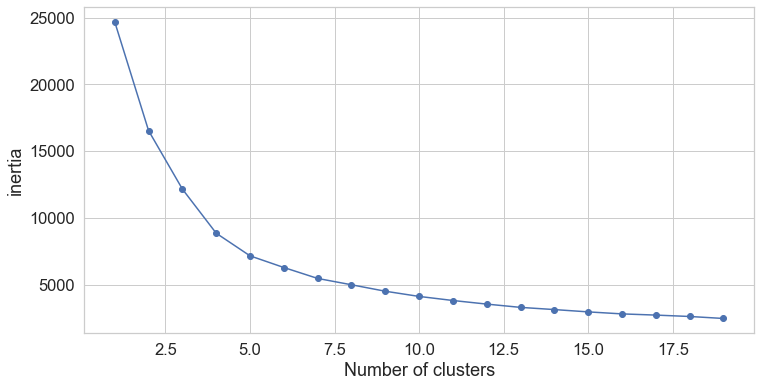

In [23]:
# Create k means inertia curve to find the optimal number of clusters


SSE=[]
for cluster in range(1,20):
    kmeans=KMeans(n_clusters=cluster,init='k-means++',random_state=42)
    kmeans.fit(train)
    SSE.append(kmeans.inertia_)

#converting result into a dataframe and plotting them
frame=pd.DataFrame({'Cluster':range(1,20),'SSE':SSE})
plt.figure(figsize=(12,6))
plt.plot(frame['Cluster'],frame['SSE'],marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('inertia')

Berdasarkan kurva, model mencapai otpimal dengan 4-5 cluster.

In [24]:
# kmeans using x clusters
kmeans=KMeans(n_clusters=4,
              init='k-means++',
              random_state=42)
kmeans.fit(train)
pred=kmeans.predict(train)
frame=pd.DataFrame(train)
frame['cluster']=pred
frame['cluster'].value_counts()


0    3004
1    2050
3     998
2     212
Name: cluster, dtype: int64

In [25]:
print(kmeans.inertia_)

8858.400851106888


## Pelatihan Model 2

Opsi model menggunakan feature purchase saja.

In [26]:
train2=pd.DataFrame(train).iloc[:, 0:3]
train2

,0,1,2
0,-0.917090,-0.469584,-0.591841
1,-0.497727,-0.320090,-0.350461
2,0.760359,-0.390178,-0.229772
3,0.131316,-0.149053,-0.310232
4,-0.917090,0.175232,-0.390691
...,...,...,...
6259,-0.917090,-0.469584,-0.591841
6260,-0.917090,-0.469584,-0.591841
6261,-0.917090,-0.469584,-0.591841
6262,0.970040,-0.376034,-0.028623


Text(0, 0.5, 'inertia')

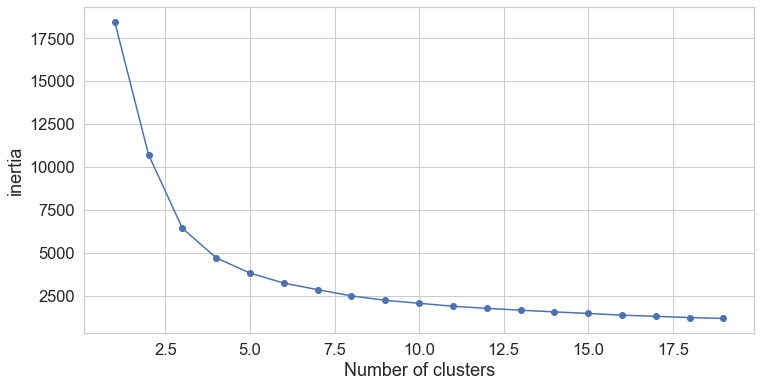

In [27]:
SSE=[]
for cluster in range(1,20):
    kmeans2=KMeans(n_clusters=cluster,init='k-means++',random_state=42)
    kmeans2.fit(train2)
    SSE.append(kmeans2.inertia_)

#converting result into a dataframe and plotting them
frame2=pd.DataFrame({'Cluster':range(1,20),'SSE':SSE})
plt.figure(figsize=(12,6))
plt.plot(frame2['Cluster'],frame2['SSE'],marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('inertia')

Model optimal dapat diperoleh dengan penggunaan 3-5  cluster. 

In [28]:
# kmeans using x clusters
kmeans2=KMeans(n_clusters=3,
              init='k-means++',
              random_state=42)
kmeans2.fit(train2)
pred2=kmeans2.predict(train2)
pd.DataFrame(pred2).value_counts()
#frame2=pd.DataFrame(train2)
#frame2['cluster']=pred2
#frame2['cluster'].value_counts()

0    3802
2    2231
1     231
dtype: int64

In [29]:
train2.head()

,0,1,2
0,-0.917090,-0.469584,-0.591841
1,-0.497727,-0.320090,-0.350461
2,0.760359,-0.390178,-0.229772
3,0.131316,-0.149053,-0.310232
4,-0.917090,0.175232,-0.390691


Dipilih 3 cluster untuk mendapatkan jumlah observasi yang cukup besar di tiap cluster.

## Evaluasi Model 1

Melihat performa model menggunakan metrics dan visualisasi

In [30]:
# return cluster center in standardized amount
kcenter=pd.DataFrame(kmeans.cluster_centers_)
kcenter.set_axis(sfeature_name, axis=1, inplace=True)
kcenter


,S_PURCHASES_INSTALLMENTS_FREQUENCY,S_PURCHASES,S_PURCHASES_TRX,S_CASH_ADVANCE_FREQUENCY
0,-0.684263,-0.266805,-0.398686,-0.285189
1,1.169701,0.157142,0.364806,-0.447202
2,1.201942,3.412824,3.797768,-0.313878
3,-0.591105,-0.297038,-0.369407,1.876447


Berdasarkan cluster center, kita dapat menyimpulkan bahwa cluster dengan installment frequency yang tinggi cenderung memiliki cash advance frequency yang rendah, pembelian yang tinggi, dan jumlah transaksi yang tinggi.

In [31]:
# return cluster centers in data x = y * standard_deviation + mean
data_desc=data.describe()

kcenter['PURCHASES_INSTALLMENTS_FREQUENCY']=kcenter['S_PURCHASES_INSTALLMENTS_FREQUENCY']*data_desc['PURCHASES_INSTALLMENTS_FREQUENCY'].loc['std']+data_desc['PURCHASES_INSTALLMENTS_FREQUENCY'].loc['mean']
kcenter['PURCHASES']=kcenter['S_PURCHASES']*data_desc['PURCHASES'].loc['std']+data_desc['PURCHASES'].loc['mean']
kcenter['PURCHASES_TRX']=kcenter['S_PURCHASES_TRX']*data_desc['PURCHASES_TRX'].loc['std']+data_desc['PURCHASES_TRX'].loc['mean']
kcenter['CASH_ADVANCE_FREQUENCY']=kcenter['S_CASH_ADVANCE_FREQUENCY']*data_desc['CASH_ADVANCE_FREQUENCY'].loc['std']+data_desc['CASH_ADVANCE_FREQUENCY'].loc['mean']

kcenter

,S_PURCHASES_INSTALLMENTS_FREQUENCY,S_PURCHASES,S_PURCHASES_TRX,S_CASH_ADVANCE_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,PURCHASES,PURCHASES_TRX,CASH_ADVANCE_FREQUENCY
0,-0.684263,-0.266805,-0.398686,-0.285189,0.092517,433.227844,4.800711,0.078065
1,1.169701,0.157142,0.364806,-0.447202,0.829377,1339.087044,23.780019,0.045641
2,1.201942,3.412824,3.797768,-0.313878,0.842192,8295.592965,109.118482,0.072324
3,-0.591105,-0.297038,-0.369407,1.876447,0.129543,368.627193,5.528545,0.510678


Untuk memperoleh gambaran yang lebih jelas tentang cluster center berdasarkan satuan asal di tiap feature/variabel, maka nilai standar dari masing-masing cluster center ditransformasi kembali menggunakan standar deviasi dan rata-rata. 

<AxesSubplot:xlabel='component1', ylabel='component2'>

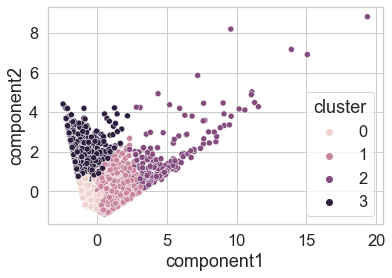

In [32]:

myPCA = PCA(n_components=2) #use PCA rather than MDS, to get the same result everytime we run the model
PCA_cc = pd.DataFrame(myPCA.fit_transform(frame.drop('cluster',axis=1)),
             columns = ['component1','component2'])
PCA_cc['cluster'] = kmeans.predict(frame.drop('cluster',axis=1))

sns.scatterplot(data=PCA_cc,x = "component1",y="component2",hue="cluster")

## Evaluasi Model 2

Melihat performa model menggunakan metrics dan visualisasi

In [33]:
kmeans2.inertia_

6435.156826392869

In [34]:
kmeans2.cluster_centers_

array([[-0.72900174, -0.29353297, -0.42375761],
       [ 1.20192998,  3.28529574,  3.64465906],
       [ 1.12114278,  0.13663994,  0.33880166]])

In [35]:
feature_name2=['PURCHASES_INSTALLMENTS_FREQUENCY','PURCHASES','PURCHASES_TRX']
sfeature_name2=['S_PURCHASES_INSTALLMENTS_FREQUENCY','S_PURCHASES','S_PURCHASES_TRX']

In [36]:
# return cluster center in standardized amount

kcenter2=pd.DataFrame(kmeans2.cluster_centers_)
kcenter2.set_axis(sfeature_name2, axis=1, inplace=True)
kcenter2


,S_PURCHASES_INSTALLMENTS_FREQUENCY,S_PURCHASES,S_PURCHASES_TRX
0,-0.729002,-0.293533,-0.423758
1,1.201930,3.285296,3.644659
2,1.121143,0.136640,0.338802


In [37]:
# return cluster centers in data x = y * standard_deviation + mean
data_desc=data.describe()

kcenter2['PURCHASES_INSTALLMENTS_FREQUENCY']=kcenter2['S_PURCHASES_INSTALLMENTS_FREQUENCY']*data_desc['PURCHASES_INSTALLMENTS_FREQUENCY'].loc['std']+data_desc['PURCHASES_INSTALLMENTS_FREQUENCY'].loc['mean']
kcenter2['PURCHASES']=kcenter2['S_PURCHASES']*data_desc['PURCHASES'].loc['std']+data_desc['PURCHASES'].loc['mean']
kcenter2['PURCHASES_TRX']=kcenter2['S_PURCHASES_TRX']*data_desc['PURCHASES_TRX'].loc['std']+data_desc['PURCHASES_TRX'].loc['mean']


kcenter2

,S_PURCHASES_INSTALLMENTS_FREQUENCY,S_PURCHASES,S_PURCHASES_TRX,PURCHASES_INSTALLMENTS_FREQUENCY,PURCHASES,PURCHASES_TRX
0,-0.729002,-0.293533,-0.423758,0.074735,376.116871,4.177476
1,1.201930,3.285296,3.644659,0.842187,8023.099840,105.312422
2,1.121143,0.136640,0.338802,0.810078,1295.279303,23.133595


<AxesSubplot:xlabel='component1', ylabel='component2'>

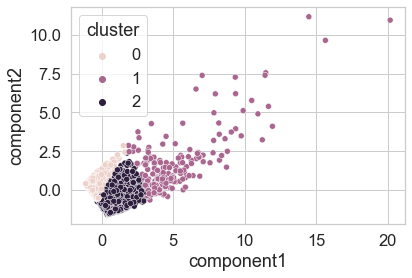

In [38]:
myPCA = PCA(n_components=2) #use PCA rather than MDS, to get the same result everytime we run the model
PCA_cc2 = pd.DataFrame(myPCA.fit_transform(train2),
             columns = ['component1','component2'])
PCA_cc2['cluster'] = kmeans2.predict(train2)

sns.scatterplot(data=PCA_cc2,x = "component1",y="component2",hue="cluster")

Berdasarkan cluster center model 2, kita tetap dapat mengelompokkan nasabah dengan installment frequency yang tinggi menggunakan jumlah variabel yang lebih sedikit. Nasabah cenderung memiliki pembelian yang tinggi, dan jumlah transaksi yang tinggi.

In [39]:
kmeans2.cluster_centers_

array([[-0.72900174, -0.29353297, -0.42375761],
       [ 1.20192998,  3.28529574,  3.64465906],
       [ 1.12114278,  0.13663994,  0.33880166]])

## Model Saving

In [40]:
filename='cc installment cluster.sav'
pickle.dump(kmeans,open(filename,'wb'))

filename2='cc installment cluster2.sav'
pickle.dump(kmeans2,open(filename2,'wb'))

## Model Inference 1

<AxesSubplot:xlabel='component1', ylabel='component2'>

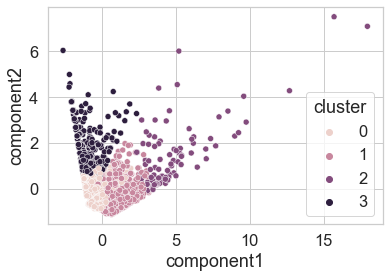

In [41]:
# load the model
loaded_model=pickle.load(open('cc installment cluster.sav','rb'))

# predict the cluster
loaded_model.predict(test)

# dekomposisi menjadi 2 pca dan visualisasi hasil dengan scatter plot
# menggunakan definisi yang sebelumnya embedding = MDS(n_components=2)
PCA_cc_test= pd.DataFrame(myPCA.fit_transform(test),
             columns = ['component1','component2'])
PCA_cc_test['cluster'] = loaded_model.predict(test)

sns.scatterplot(data=PCA_cc_test,x = "component1",y="component2",hue="cluster")

In [42]:
# jumlah data di tiap cluster data test
PCA_cc_test['cluster'].value_counts()

0    1300
1     876
3     410
2      99
Name: cluster, dtype: int64

In [43]:
# membuat fungsi penentuan cluster berdasarkan inputan yang belum distandarisasi

def myKmeans(insFreq,Pur,PurTrx,CAFreq):
    #standardized
    s_insFreq=(insFreq-data_desc['PURCHASES_INSTALLMENTS_FREQUENCY'].loc['mean'])/data_desc['PURCHASES_INSTALLMENTS_FREQUENCY'].loc['std']
    s_Pur=(Pur-data_desc['PURCHASES'].loc['mean'])/data_desc['PURCHASES'].loc['std']
    s_PurTrx=(PurTrx-data_desc['PURCHASES_TRX'].loc['mean'])/data_desc['PURCHASES_TRX'].loc['std']
    s_CAFreq=(CAFreq-data_desc['CASH_ADVANCE_FREQUENCY'].loc['mean'])/data_desc['CASH_ADVANCE_FREQUENCY'].loc['std']
    
    # load the model
    loaded_model=pickle.load(open('cc installment cluster.sav','rb'))

    # predict the cluster
    x=loaded_model.predict([[s_insFreq,s_Pur,s_PurTrx,s_CAFreq]])
    print('Cluster:',x) 
    
myKmeans(0.2,8000,30,0.03)

Cluster: [1]


## Model Inference 2

<AxesSubplot:xlabel='component1', ylabel='component2'>

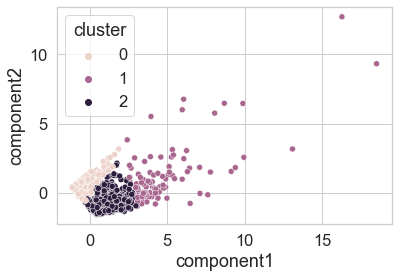

In [44]:
# load the model
loaded_model2=pickle.load(open('cc installment cluster2.sav','rb'))

# predict the cluster
test2=pd.DataFrame(test).iloc[:,0:3] #mengambil 3 feature paling kiri
loaded_model2.predict(test2)

# dekomposisi menjadi 2 pca dan visualisasi hasil dengan scatter plot
# menggunakan definisi yang sebelumnya embedding = MDS(n_components=2)
PCA_cc_test2= pd.DataFrame(myPCA.fit_transform(test2),
             columns = ['component1','component2'])
PCA_cc_test2['cluster'] = loaded_model2.predict(test2)

sns.scatterplot(data=PCA_cc_test2,x = "component1",y="component2",hue="cluster")

Model 2 dapat membagi data test kedalam cluster-cluster dengan batasan berupa garis linier. 

In [45]:
# membuat fungsi penentuan cluster berdasarkan inputan yang belum distandarisasi

def myKmeans2(insFreq,Pur,PurTrx):
    #standardized
    s_insFreq=(insFreq-data_desc['PURCHASES_INSTALLMENTS_FREQUENCY'].loc['mean'])/data_desc['PURCHASES_INSTALLMENTS_FREQUENCY'].loc['std']
    s_Pur=(Pur-data_desc['PURCHASES'].loc['mean'])/data_desc['PURCHASES'].loc['std']
    s_PurTrx=(PurTrx-data_desc['PURCHASES_TRX'].loc['mean'])/data_desc['PURCHASES_TRX'].loc['std']
    
    
    # load the model
    loaded_model2=pickle.load(open('cc installment cluster2.sav','rb'))

    # predict the cluster
    x=loaded_model2.predict([[s_insFreq,s_Pur,s_PurTrx]])
    print('Cluster:',x) 
    
myKmeans2(0.2,8000,30)

Cluster: [1]


## Kesimpulan

Dalam pengolahan data, disusun 2 model K-nearest neighbor model. Diusulkan model 2 dengan menggunakan feature yang lebih sedikit namun inertia yang lebih rendah.

Dalam melakukan pemasaran offering perubahan transaksi menjadi cicilan dapat menargetkan cluster 1 dan 2 yang memiliki frekuensi installment di kisaran 0.80. Cluster memiliki kecenderungan nominal transaksi dan jumlah transaksi yang tinggi. Cluster 1, dapat diberikan suku bunga khusus dengan mempertibangkan nominal dan jumlah transaksi yang lebih besar.

In [46]:
kcenter2.iloc[:,-3:]

,PURCHASES_INSTALLMENTS_FREQUENCY,PURCHASES,PURCHASES_TRX
0,0.074735,376.116871,4.177476
1,0.842187,8023.099840,105.312422
2,0.810078,1295.279303,23.133595
